<a href="https://colab.research.google.com/github/fr3d3rico/mvp-sprint-1-analise-temperatura/blob/main/mvp_sprint_1_analise_temperatura.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MVP de Análise de Dados e Boas Práticas

Sprint 1 - Pós-graduação Ciência de Dados - PUC Rio

Aluno: Frederico Araújo Soares

# 1. Definição do Problema


Será analisado neste MVP os dados de clima disponibilizados pelo Institudo Nacional de Metereologia - INMET.

O dataset possui uma coluna(feature) chamado **PRECIPITAÇÃO TOTAL, HORÁRIO (mm)**. Esta será nossa feature preditora.



## 1.1. Informações Sobre o Dataset

O Instituto Nacional de Metereologia (INMET) está hoje sob a pasta do Ministério da Agricultura e Pecuária.

O Sistema de Coleta e Distribuição de Dados Meteorológicos do Instituto (temperatura, umidade relativa do ar, direção e velocidade do vento, pressão atmosférica, precipitação, entre outras variáveis) é dotado de estações de sondagem de ar superior (radiossonda); estações meteorológicas de superfície, operadas manualmente; e a maior rede de estações automáticas da América do Sul.

A rede de estações meteorológicas automáticas utiliza o que há de mais moderno internacionalmente. Os dados coletados por essa rede são disseminados, de forma democrática e gratuita, em tempo real, na página https://portal.inmet.gov.br, e têm aplicação em todos os setores da economia, de modo especial no agropecuário e em apoio à Defesa Civil.

Os dados estão presentes nos seguintes links:

Dados INMET: https://portal.inmet.gov.br/dadoshistoricos

O link direto para os dados de 2023: https://portal.inmet.gov.br/uploads/dadoshistoricos/2023.zip

O arquivo ZIP possui todos os dados das estações coletadas no Brasil. É necessário verificar nestes dados qual a estação próxima do seu interesse para a análise. Aqui será analisado os dados da estação da cidade de Goiânia. Será disponibilizado dados das cidades de São Paulo e Rio de janeiro caso deseje verificar.

## 1.3. Bibliotecas Python Utilizadas

In [1]:
import pandas as pd
import numpy as np
import missingno as ms
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

# 2. Carga de Dados

O início da análise começa com carregamento em memória dos dados do dataset. A biblieoteca Pandas, aqui sendo utilizada pela variável pd será utilizada para o carregamento.
Um dos parâmetros utilizado é o skiprows. Este parametro recebe a quantidade de linhas que se dejesa ignorar. Em cada dataset presente nos dados do INMET, contêm os dados da região, nome da cidade, latitude e longitude da estão e outros. E todas as 8 primeiras linhas serão ignoradas.

In [2]:
urlDataSet = 'https://raw.githubusercontent.com/fr3d3rico/mvp-sprint-1-analise-temperatura/main/INMET_CO_GO_A002_GOIANIA_01-01-2023_A_30-11-2023.CSV'

dataset = pd.read_csv(urlDataSet, delimiter=';', encoding='unicode_escape', skiprows=8)

# 3. Análise de Dados

A análise dos dados envolve a verificação se estão todos formatados e com o dataset carregado em memória para processamento sem erros e alertas.

Uma primeira verificação básica é validar se os dados foram carregados e estão presentes nas features esperadas. Para isso vamos visualizar as primeiras e últimoas instâncias do dataset.

In [3]:
# Validação se os dados foram carregados com sucesso. Visualizando as primeiras linhas do dataset
dataset.head()

,Data,Hora UTC,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19
0,2023/01/01,0000 UTC,0,"933,2","933,2","932,5",NaN,"21,1","19,2","21,3","21,1","19,6","19,1",90.0,88.0,89.0,115.0,"4,4","1,1",NaN
1,2023/01/01,0100 UTC,0,933,"933,3",933,NaN,"21,1","19,3","21,2","21,1","19,5","19,2",90.0,89.0,90.0,114.0,"2,4",",5",NaN
2,2023/01/01,0200 UTC,0,933,933,"932,8",NaN,"20,7","19,3","21,1","20,7","19,4","19,1",92.0,90.0,92.0,33.0,"1,6",0,NaN
3,2023/01/01,0300 UTC,0,"932,7","933,2","932,7",NaN,"20,7","19,4","20,8","20,5","19,4","19,1",92.0,92.0,92.0,148.0,"2,1",",7",NaN
4,2023/01/01,0400 UTC,0,"932,2","932,7","932,2",NaN,"20,5","19,1","20,7","20,5","19,3","19,1",92.0,92.0,92.0,146.0,"2,2",",8",NaN


In [4]:
# Visualizando as últimas linhas do dataset
dataset.tail()

,Data,Hora UTC,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19
8011,2023/11/30,1900 UTC,0,"930,6","930,8","928,9","265,4","25,3","17,5","28,8","25,3","18,1","16,4",64.0,50.0,62.0,205.0,"7,8","3,8",NaN
8012,2023/11/30,2000 UTC,0,"930,1","930,6",930,"54,6","25,1","18,1","25,6","24,9","18,1","16,6",66.0,57.0,65.0,137.0,"7,8",1,NaN
8013,2023/11/30,2100 UTC,",2",930,"930,1","929,9","19,7",23,19,"25,1",23,19,"17,9",78.0,65.0,78.0,121.0,"4,3","2,1",NaN
8014,2023/11/30,2200 UTC,0,"930,4","930,4",930,",4","22,1","19,6",23,22,"19,8","18,9",86.0,78.0,86.0,209.0,"4,3",",7",NaN
8015,2023/11/30,2300 UTC,0,931,931,"930,4",NaN,"22,6","19,9","22,7","22,1",20,"19,7",86.0,84.0,85.0,116.0,"2,2",",2",NaN


### Abreviando os nomes para facilitar na hora de fazer a impressão dos gráficos

Para facilitar a impressão de gráficos nos passos seguintes, foi necessário abreviar alguns dos nomes das features. A abreviação ainda continuar mantendo o seu significado, mas pode ser consultado aqui nesta seção caso necessário.

In [5]:
# Abreviando os nomes das colunas
dataset = dataset.rename(columns={
'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)': 'PREC.TOTAL,HORA(mm)',
'PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)': 'PRES.ATM.NIVEL ESTACAO,HORA(mB)',
'PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)': 'PRES.ATM.MAX.HORA ANT.(AUT)(mB)',
'PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)': 'PRES.ATM.MIN.HORA ANT.(AUT)(mB)',
'RADIACAO GLOBAL (Kj/m²)': 'RADIACAO GLOBAL(Kj/m²)',
'TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)': 'TEMP.AR-BULBO SECO,HORA(°C)',
'TEMPERATURA DO PONTO DE ORVALHO (°C)': 'TEMP.PONTO ORVALHO(°C)',
'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)': 'TEMP.MAX.HORA ANT.(AUT)(°C)',
'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)': 'TEMP.MIN.HORA ANT.(AUT)(°C)',
'TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)': 'TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)',
'TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)': 'TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)',
'UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)': 'UMIDADE REL.MAX.HORA ANT.(AUT)(%)',
'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)': 'UMIDADE REL.MIN.HORA ANT.(AUT)(%)',
'UMIDADE RELATIVA DO AR, HORARIA (%)': 'UMIDADE RELATIVA AR,HORA(%)',
'VENTO, DIREÇÃO HORARIA (gr) (° (gr))': 'VENTO, DIRECAO HORARIA(gr)(°(gr))',
'VENTO, RAJADA MAXIMA (m/s)': 'VENTO, RAJADA MAX.(m/s)',
'VENTO, VELOCIDADE HORARIA (m/s)': 'VENTO, VELOCIDADE HORARIA(m/s)'
}, errors="raise")

## 3.1. Estatísticas Descritivas

## 3.2. Dados Técnicos

Vamos iniciar visualizando o formato ou a dimensão do dataset.

In [6]:
# Visualizando as dimensões do dataset
print(dataset.shape)

(8016, 20)


Vamos verificar os dados técnicos sobre os tipos de variáveis presentes em cada feature que foi identificado no carregamento inicial da biblioteca Pandas.

In [7]:
# Mostra informações técnicas do dataset
print(dataset.dtypes)

Data                                    object
Hora UTC                                object
PREC.TOTAL,HORA(mm)                     object
PRES.ATM.NIVEL ESTACAO,HORA(mB)         object
PRES.ATM.MAX.HORA ANT.(AUT)(mB)         object
PRES.ATM.MIN.HORA ANT.(AUT)(mB)         object
RADIACAO GLOBAL(Kj/m²)                  object
TEMP.AR-BULBO SECO,HORA(°C)             object
TEMP.PONTO ORVALHO(°C)                  object
TEMP.MAX.HORA ANT.(AUT)(°C)             object
TEMP.MIN.HORA ANT.(AUT)(°C)             object
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)     object
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)     object
UMIDADE REL.MAX.HORA ANT.(AUT)(%)      float64
UMIDADE REL.MIN.HORA ANT.(AUT)(%)      float64
UMIDADE RELATIVA AR,HORA(%)            float64
VENTO, DIRECAO HORARIA(gr)(°(gr))      float64
VENTO, RAJADA MAX.(m/s)                 object
VENTO, VELOCIDADE HORARIA(m/s)          object
Unnamed: 19                            float64
dtype: object


Vamos verificar o tamanho do dataset. Veja que é mostrado as seguintes informações:
- Total de features
- Nomes das features
- Tipo de dados (aqui no caso object e float64 presentes)
- O tipo do dataset (pandas.core.frame.DataFrame)
- O total de linhas (RangeIndex)
- A quantidade de linhas não nulas para cada feature
- Total de memória utilizada (memory usage)

In [8]:
print(dataset.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8016 entries, 0 to 8015
Data columns (total 20 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Data                                 8016 non-null   object 
 1   Hora UTC                             8016 non-null   object 
 2   PREC.TOTAL,HORA(mm)                  8014 non-null   object 
 3   PRES.ATM.NIVEL ESTACAO,HORA(mB)      8014 non-null   object 
 4   PRES.ATM.MAX.HORA ANT.(AUT)(mB)      8013 non-null   object 
 5   PRES.ATM.MIN.HORA ANT.(AUT)(mB)      8013 non-null   object 
 6   RADIACAO GLOBAL(Kj/m²)               4197 non-null   object 
 7   TEMP.AR-BULBO SECO,HORA(°C)          8014 non-null   object 
 8   TEMP.PONTO ORVALHO(°C)               8014 non-null   object 
 9   TEMP.MAX.HORA ANT.(AUT)(°C)          8013 non-null   object 
 10  TEMP.MIN.HORA ANT.(AUT)(°C)          8013 non-null   object 
 11  TEMP.ORVALHO MAX.HORA ANT.(AUT

Vamos realizar um análise estatística básica sobre o nosso dataset. Este resumo mostra dados de cada feature como:
- Média
- Desvio Padrão
- Valor Mínimo
- Valor Máximo
- Valores do Quartis

Veja que temos um problema. Acima quando analisamos os dados técnicos carregados, foi visualizado que existem 20 colunas (features). Mas aqui na análise estatística foi apresentado somente 5 colunas.

In [9]:
# Análise estatística básica inicial (média, desvio padrão, mínimo, máximo e os quartis)
dataset.describe()

,UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))",Unnamed: 19
count,8013.000000,8013.000000,8014.000000,8013.000000,0.0
mean,66.842381,59.879945,63.317195,169.867465,NaN
std,20.917222,22.520974,21.923410,104.215153,NaN
min,13.000000,11.000000,12.000000,1.000000,NaN
25%,51.000000,41.000000,46.000000,92.000000,NaN
50%,71.000000,62.000000,66.000000,138.000000,NaN
75%,86.000000,80.000000,83.000000,264.000000,NaN
max,94.000000,94.000000,94.000000,360.000000,NaN


## 3.3. Visualizações Unimodais

Na análise anterior vimos que existe algum problema com o dataset. Vamos verificar se ocorre também no momento de visualizar o gráfico de histograma.

array([[<Axes: title={'center': 'UMIDADE REL.MAX.HORA ANT.(AUT)(%)'}>,
        <Axes: title={'center': 'UMIDADE REL.MIN.HORA ANT.(AUT)(%)'}>],
       [<Axes: title={'center': 'UMIDADE RELATIVA AR,HORA(%)'}>,
        <Axes: title={'center': 'VENTO, DIRECAO HORARIA(gr)(°(gr))'}>],
       [<Axes: title={'center': 'Unnamed: 19'}>, <Axes: >]], dtype=object)

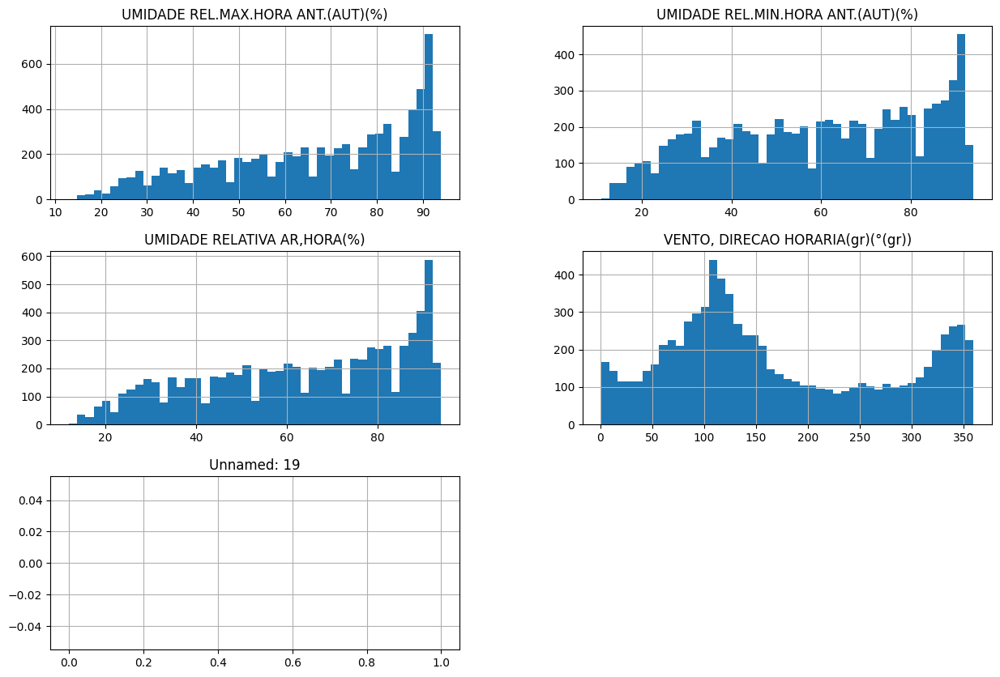

In [10]:
# Histograma
dataset.hist(bins=45, figsize = (15,10))

## 3.4. Visualizações Multimodais

Vamos verificar se o gráfico de correlações está com problemas também.

<ipython-input-11-ccdd7d984193>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(dataset.corr(), annot=True, cmap='RdBu', vmin=-1, vmax=1)


<Axes: >

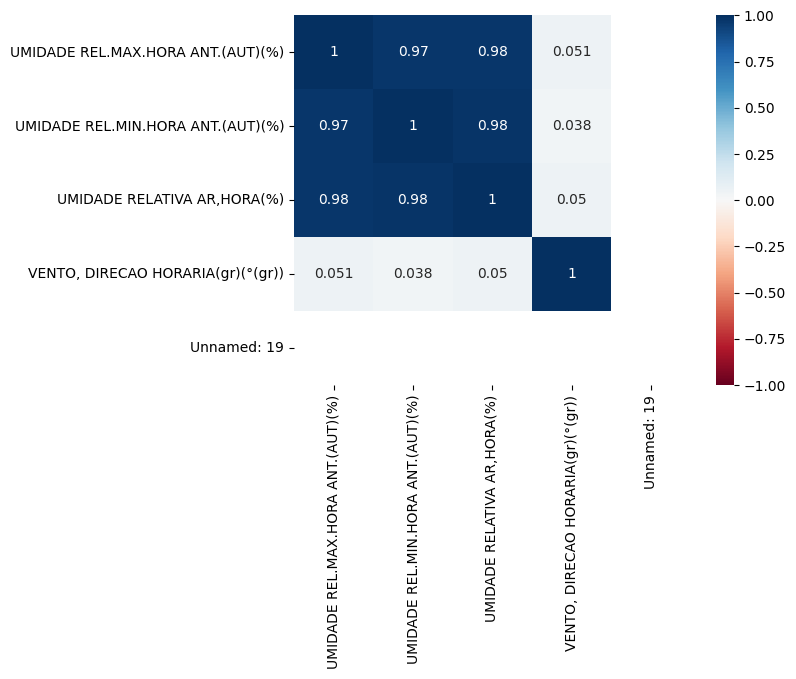

In [11]:
# Matriz de Correlação com Matplotlib Seaborn utilizando o método Pearson
sns.heatmap(dataset.corr(), annot=True, cmap='RdBu', vmin=-1, vmax=1)

## 3.5. Resultado Análise de Dados

Vimos que a análise inicial apresentou alguns problemas. O carregamento do dataset foi realizada com sucesso. Mas existem alguns problemas no dataset.

Ao mostrar novamente abaixo as primeiras linhas com o comando `head()` vemos que algumas features apresentam os seguintes problemas:

- Dados não presentes (NaN)
- Valores informados com vírgula (Python espera que seja ponto)
- Uma coluna com um nome estranho chamada **Unnamed: 19**

In [12]:
dataset.head()

,Data,Hora UTC,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C),TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C),UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",Unnamed: 19
0,2023/01/01,0000 UTC,0,"933,2","933,2","932,5",NaN,"21,1","19,2","21,3","21,1","19,6","19,1",90.0,88.0,89.0,115.0,"4,4","1,1",NaN
1,2023/01/01,0100 UTC,0,933,"933,3",933,NaN,"21,1","19,3","21,2","21,1","19,5","19,2",90.0,89.0,90.0,114.0,"2,4",",5",NaN
2,2023/01/01,0200 UTC,0,933,933,"932,8",NaN,"20,7","19,3","21,1","20,7","19,4","19,1",92.0,90.0,92.0,33.0,"1,6",0,NaN
3,2023/01/01,0300 UTC,0,"932,7","933,2","932,7",NaN,"20,7","19,4","20,8","20,5","19,4","19,1",92.0,92.0,92.0,148.0,"2,1",",7",NaN
4,2023/01/01,0400 UTC,0,"932,2","932,7","932,2",NaN,"20,5","19,1","20,7","20,5","19,3","19,1",92.0,92.0,92.0,146.0,"2,2",",8",NaN


# 4. Pré-Processamento de dados

Nesta etapa precisamos corrigir os problemas identificados na análise dos dados na seção anterior e verificar outras questões como:
- Valores faltantes (missings)
- Valores inconsistentes
- Intervalo dos valores
- Unidades de medida

Para isso são utilizadas algumas técnicas. Estas são:
- Limpeza: Que analisa as redundâncias, Outliers e Missings
- Agregação: Que combina dois ou mais dados
- Amostragem com Holdout ou Cross Validation
- Normalização
- Padronização
- Discretização
- One-hot enconding e Dummy enconding
- Feature selection

## 4.1. Tratamento de Missings

Vamos iniciar com o tratamento de missings.

In [13]:
# Verificando a quantidade de dados faltantes
dataset.isnull().sum()

Data                                      0
Hora UTC                                  0
PREC.TOTAL,HORA(mm)                       2
PRES.ATM.NIVEL ESTACAO,HORA(mB)           2
PRES.ATM.MAX.HORA ANT.(AUT)(mB)           3
PRES.ATM.MIN.HORA ANT.(AUT)(mB)           3
RADIACAO GLOBAL(Kj/m²)                 3819
TEMP.AR-BULBO SECO,HORA(°C)               2
TEMP.PONTO ORVALHO(°C)                    2
TEMP.MAX.HORA ANT.(AUT)(°C)               3
TEMP.MIN.HORA ANT.(AUT)(°C)               3
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)       3
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)       3
UMIDADE REL.MAX.HORA ANT.(AUT)(%)         3
UMIDADE REL.MIN.HORA ANT.(AUT)(%)         3
UMIDADE RELATIVA AR,HORA(%)               2
VENTO, DIRECAO HORARIA(gr)(°(gr))         3
VENTO, RAJADA MAX.(m/s)                   3
VENTO, VELOCIDADE HORARIA(m/s)            3
Unnamed: 19                            8016
dtype: int64

<Axes: >

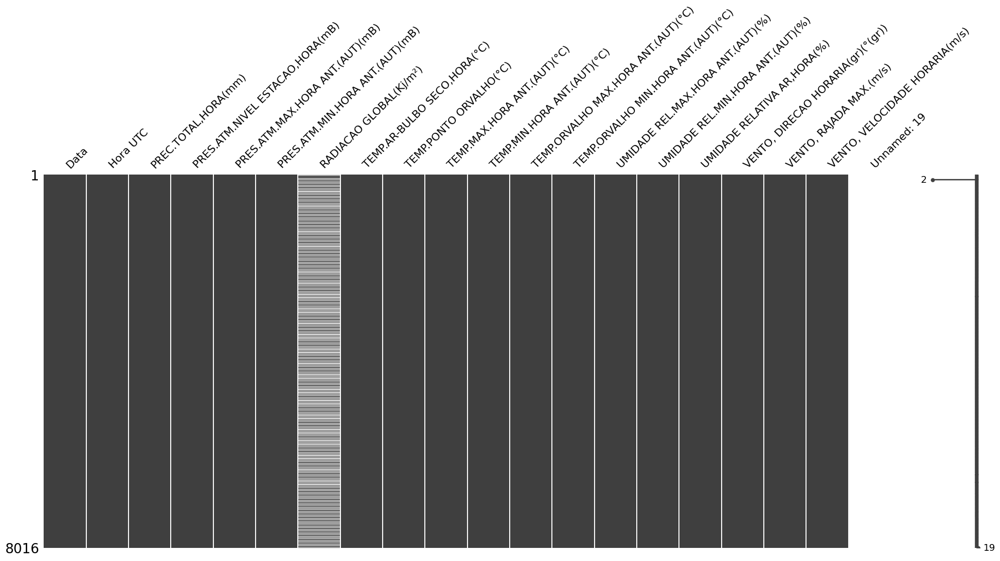

In [14]:
# salvando um NOVO dataset para tratamento de missings (cuidado para não sobrescrever o dataset original!)

# recuperando os nomes das colunas
col = list(dataset.columns)

# o novo dataset irá conter todas as colunas com exceção da última (classe)
atributos = dataset

# exibindo visualização matricial da nulidade do dataset
ms.matrix(atributos)

In [15]:
# Excluindo a feaure sem dados
dataset = dataset.drop(['Unnamed: 19'], axis=1)

In [16]:
# Excluindo as instâncias de dados que possuem ao menos 1 feature faltante
dataset = dataset.dropna()

<Axes: >

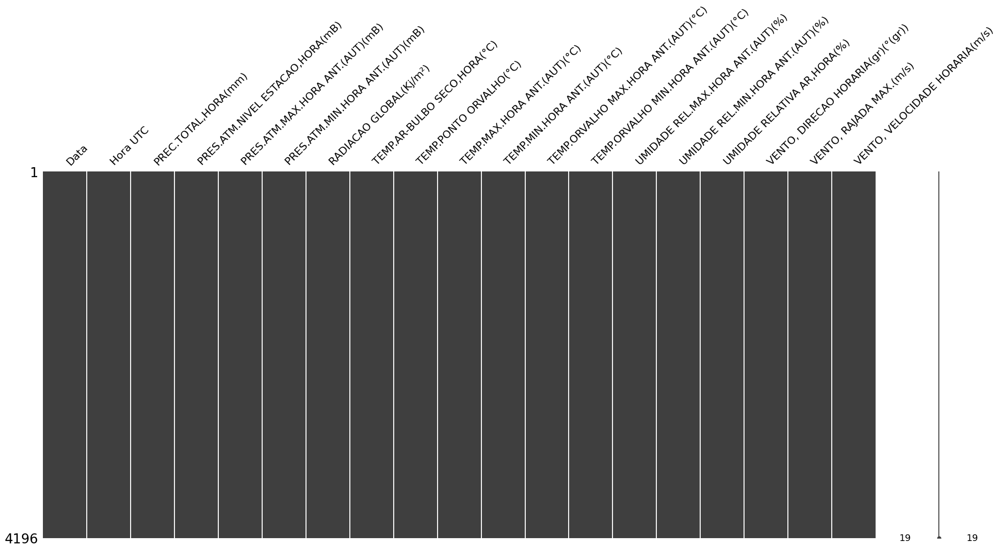

In [17]:
# salvando um NOVO dataset para tratamento de missings (cuidado para não sobrescrever o dataset original!)

# recuperando os nomes das colunas
col = list(dataset.columns)

# o novo dataset irá conter todas as colunas com exceção da última (classe)
atributos = dataset

# exibindo visualização matricial da nulidade do dataset
ms.matrix(atributos)

In [18]:
# Confirmando que agora não existem mais dados missing
dataset.isnull().sum()

Data                                   0
Hora UTC                               0
PREC.TOTAL,HORA(mm)                    0
PRES.ATM.NIVEL ESTACAO,HORA(mB)        0
PRES.ATM.MAX.HORA ANT.(AUT)(mB)        0
PRES.ATM.MIN.HORA ANT.(AUT)(mB)        0
RADIACAO GLOBAL(Kj/m²)                 0
TEMP.AR-BULBO SECO,HORA(°C)            0
TEMP.PONTO ORVALHO(°C)                 0
TEMP.MAX.HORA ANT.(AUT)(°C)            0
TEMP.MIN.HORA ANT.(AUT)(°C)            0
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)    0
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)    0
UMIDADE REL.MAX.HORA ANT.(AUT)(%)      0
UMIDADE REL.MIN.HORA ANT.(AUT)(%)      0
UMIDADE RELATIVA AR,HORA(%)            0
VENTO, DIRECAO HORARIA(gr)(°(gr))      0
VENTO, RAJADA MAX.(m/s)                0
VENTO, VELOCIDADE HORARIA(m/s)         0
dtype: int64

In [19]:
# Vamos verificar os dados restantes
dataset.shape

(4196, 19)

## 4.2. Aplicando Ordenação de Dados Pela Data e Hora

In [20]:
dataset = dataset.sort_values(by=['Data', 'Hora UTC'])

## 4.2. Transformações Tipos de Dados

Após o tratamento de dados faltantes, vamos verificar as estatísticas básicas.
Veja que ainda continua mostrando somente 5 features do dataset.
O motivo é que os dados estão armazenados no dataset com virgula, porém o Python espera o ponto como formatação de ponto de flutuante.

In [21]:
dataset.describe()

,UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))"
count,4196.000000,4196.000000,4196.000000,4196.000000
mean,58.425643,49.131554,52.498093,177.263823
std,21.763436,21.404952,21.238859,101.251307
min,13.000000,11.000000,12.000000,1.000000
25%,40.000000,31.000000,34.000000,96.000000
50%,58.000000,46.000000,51.000000,154.000000
75%,78.000000,65.000000,69.000000,268.000000
max,94.000000,94.000000,94.000000,360.000000


Vamos realizar a troca do tipo de dados de todas as colunas que não seja a Data e Hora.

In [22]:
# Mudando os tipos de dados para float
for column in dataset.columns:
    if dataset[column].dtype == 'object' and column != 'Data' and column != 'Hora UTC':
        dataset[column] = dataset[column].str.replace(',', '.').astype(float)

dataset.dtypes

Data                                    object
Hora UTC                                object
PREC.TOTAL,HORA(mm)                    float64
PRES.ATM.NIVEL ESTACAO,HORA(mB)        float64
PRES.ATM.MAX.HORA ANT.(AUT)(mB)        float64
PRES.ATM.MIN.HORA ANT.(AUT)(mB)        float64
RADIACAO GLOBAL(Kj/m²)                 float64
TEMP.AR-BULBO SECO,HORA(°C)            float64
TEMP.PONTO ORVALHO(°C)                 float64
TEMP.MAX.HORA ANT.(AUT)(°C)            float64
TEMP.MIN.HORA ANT.(AUT)(°C)            float64
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)    float64
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)    float64
UMIDADE REL.MAX.HORA ANT.(AUT)(%)      float64
UMIDADE REL.MIN.HORA ANT.(AUT)(%)      float64
UMIDADE RELATIVA AR,HORA(%)            float64
VENTO, DIRECAO HORARIA(gr)(°(gr))      float64
VENTO, RAJADA MAX.(m/s)                float64
VENTO, VELOCIDADE HORARIA(m/s)         float64
dtype: object

In [23]:
# Agora veja que a estatística básica já está sendo calculada para todas as features
dataset.describe()

,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C),TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C),UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)"
count,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000,4196.000000
mean,0.165586,932.446425,932.808580,932.205553,1383.180005,27.038966,15.046973,27.886630,25.706554,16.203170,14.119948,58.425643,49.131554,52.498093,177.263823,4.300739,1.207984
std,1.656671,2.846293,2.799027,2.840902,1078.713430,4.783271,4.378383,5.023954,4.986382,4.192052,4.460187,21.763436,21.404952,21.238859,101.251307,2.116047,0.846213
min,0.000000,924.400000,924.800000,924.200000,0.000000,10.800000,-0.800000,11.200000,10.500000,1.300000,-1.700000,13.000000,11.000000,12.000000,1.000000,0.000000,0.000000
25%,0.000000,930.500000,930.800000,930.200000,317.375000,23.800000,11.800000,24.600000,22.300000,13.000000,11.000000,40.000000,31.000000,34.000000,96.000000,2.800000,0.600000
50%,0.000000,932.400000,932.800000,932.200000,1242.700000,27.500000,16.300000,28.600000,26.200000,17.600000,15.300000,58.000000,46.000000,51.000000,154.000000,4.100000,1.100000
75%,0.000000,934.500000,934.800000,934.200000,2350.200000,30.400000,18.700000,31.400000,29.200000,19.600000,17.900000,78.000000,65.000000,69.000000,268.000000,5.600000,1.700000
max,59.000000,941.800000,941.900000,941.500000,3963.700000,39.000000,22.400000,39.400000,37.500000,23.600000,21.100000,94.000000,94.000000,94.000000,360.000000,17.500000,6.200000


Vamos agora transformar a coluna **Data** do tipo object para datetime. Com essa mudança, poderemos realizar uma visualização gráfica temporal da quantidade de precipitação por mês.

In [24]:
# Transformando a feature Data para o tipo datetime para podermos fazer análise temporal
dataset["Data"] =  pd.to_datetime(dataset["Data"], format="%Y/%m/%d")

In [25]:
# Confirmando a alteração do tipo da Data para dateime
dataset.dtypes

Data                                   datetime64[ns]
Hora UTC                                       object
PREC.TOTAL,HORA(mm)                           float64
PRES.ATM.NIVEL ESTACAO,HORA(mB)               float64
PRES.ATM.MAX.HORA ANT.(AUT)(mB)               float64
PRES.ATM.MIN.HORA ANT.(AUT)(mB)               float64
RADIACAO GLOBAL(Kj/m²)                        float64
TEMP.AR-BULBO SECO,HORA(°C)                   float64
TEMP.PONTO ORVALHO(°C)                        float64
TEMP.MAX.HORA ANT.(AUT)(°C)                   float64
TEMP.MIN.HORA ANT.(AUT)(°C)                   float64
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)           float64
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)           float64
UMIDADE REL.MAX.HORA ANT.(AUT)(%)             float64
UMIDADE REL.MIN.HORA ANT.(AUT)(%)             float64
UMIDADE RELATIVA AR,HORA(%)                   float64
VENTO, DIRECAO HORARIA(gr)(°(gr))             float64
VENTO, RAJADA MAX.(m/s)                       float64
VENTO, VELOCIDADE HORARIA(m/

## 4.2. Tratamento de Redundâncias

Outra técnica importante é a validação se existem instâncias duplicadas.

In [26]:
# Mostra a quantidade de instâncias duplicadas
dataset.duplicated().sum()

0

In [27]:
# Mostra a quantidade de instâncias duplicadas levando em consideração somente a combinação de Data e Hora
dataset.duplicated(subset=['Data','Hora UTC']).sum()

0

## 4.3. Tratamento de Outliers

Aqui no gráfico do BoxPlot vemos que existem dados Outliers. Porém ao analisar vemos que ele podem ter entrado como outlier depois que quase metade das instnces foram eliminadas do dataset após o tratamento de missings.

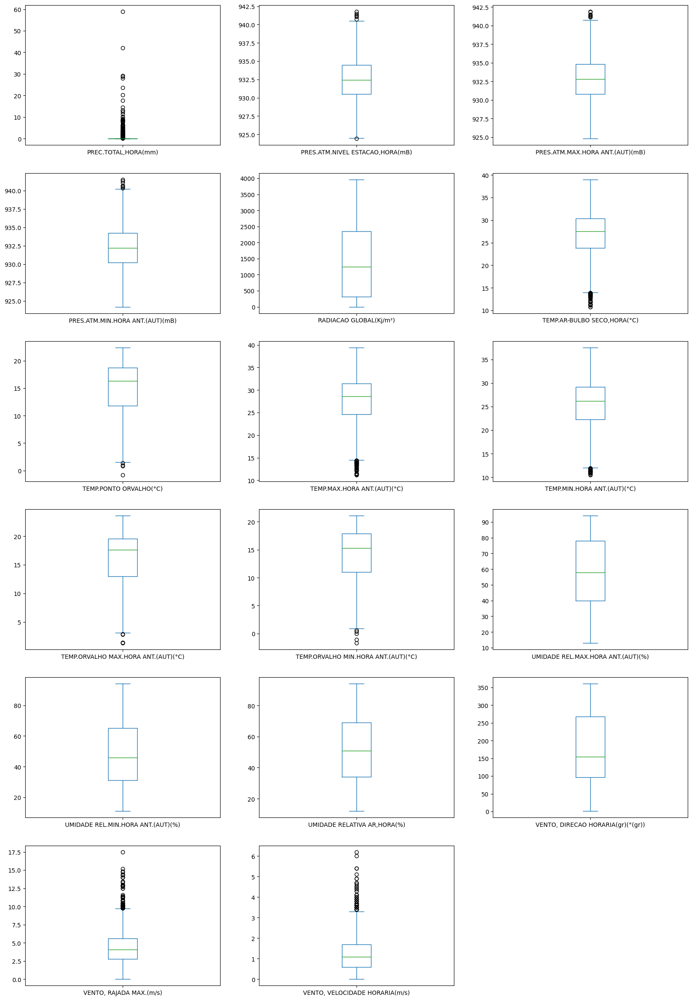

In [28]:
# Boxplot
dataset.plot(kind = 'box', subplots = True, layout = (8,3), sharex = False, sharey = False, figsize = (20,40))
plt.show()

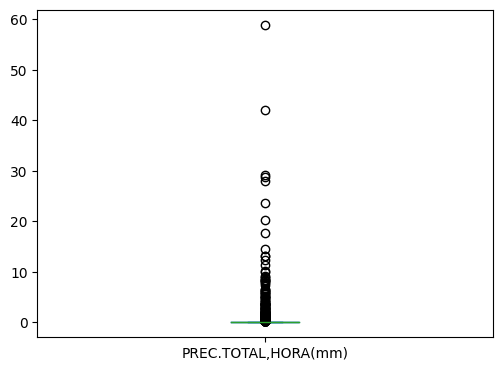

count    4196.000000
mean        0.165586
std         1.656671
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max        59.000000
Name: PREC.TOTAL,HORA(mm), dtype: float64


In [29]:
# Boxplot
dataset['PREC.TOTAL,HORA(mm)'].plot(kind = 'box', subplots = True, layout = (8,3), sharex = False, sharey = False, figsize = (20,40))
plt.show()
print(dataset['PREC.TOTAL,HORA(mm)'].describe())

## 4.4. Tratamento One-Hot Encode e Dummy Encode

In [30]:
# criando a coluna do mês
dataset['MES(NUMERO)'] = dataset['Data'].dt.month
dataset.head()

,Data,Hora UTC,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C),TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C),UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO)
9,2023-01-01,0900 UTC,0.0,932.1,932.1,931.4,23.1,19.5,18.3,19.5,18.9,18.3,17.7,93.0,93.0,93.0,124.0,2.1,1.2,1
10,2023-01-01,1000 UTC,0.0,932.6,932.6,932.1,262.0,20.6,19.2,20.6,19.5,19.2,18.3,93.0,92.0,92.0,151.0,2.2,0.4,1
11,2023-01-01,1100 UTC,0.0,933.1,933.2,932.6,350.2,21.8,19.7,21.8,20.6,19.8,19.2,92.0,88.0,88.0,126.0,1.7,0.7,1
12,2023-01-01,1200 UTC,0.0,933.4,933.5,933.1,535.7,22.9,19.7,22.9,21.7,19.7,19.3,88.0,82.0,82.0,129.0,2.5,0.6,1
13,2023-01-01,1300 UTC,0.0,933.6,933.7,933.4,1124.0,25.1,20.2,25.2,22.9,20.8,19.3,82.0,74.0,74.0,124.0,2.0,0.6,1


In [31]:
dataset.columns

Index(['Data', 'Hora UTC', 'PREC.TOTAL,HORA(mm)',
       'PRES.ATM.NIVEL ESTACAO,HORA(mB)', 'PRES.ATM.MAX.HORA ANT.(AUT)(mB)',
       'PRES.ATM.MIN.HORA ANT.(AUT)(mB)', 'RADIACAO GLOBAL(Kj/m²)',
       'TEMP.AR-BULBO SECO,HORA(°C)', 'TEMP.PONTO ORVALHO(°C)',
       'TEMP.MAX.HORA ANT.(AUT)(°C)', 'TEMP.MIN.HORA ANT.(AUT)(°C)',
       'TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)',
       'TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)',
       'UMIDADE REL.MAX.HORA ANT.(AUT)(%)',
       'UMIDADE REL.MIN.HORA ANT.(AUT)(%)', 'UMIDADE RELATIVA AR,HORA(%)',
       'VENTO, DIRECAO HORARIA(gr)(°(gr))', 'VENTO, RAJADA MAX.(m/s)',
       'VENTO, VELOCIDADE HORARIA(m/s)', 'MES(NUMERO)'],
      dtype='object')

In [32]:
dataset['PREC.TOTAL,HORA(mm) (MEDIA)'] = dataset['PREC.TOTAL,HORA(mm)'].rolling(window=3, min_periods=1).mean()
dataset['UMIDADE RELATIVA AR,HORA(%) (MEDIA)'] = dataset['UMIDADE RELATIVA AR,HORA(%)'].rolling(window=3, min_periods=1).mean()
dataset['TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)'] = dataset['TEMP.AR-BULBO SECO,HORA(°C)'].rolling(window=3, min_periods=1).mean()
dataset['RADIACAO GLOBAL(Kj/m²) (MEDIA)'] = dataset['RADIACAO GLOBAL(Kj/m²)'].rolling(window=3, min_periods=1).mean()

dataset.head()

,Data,Hora UTC,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),...,UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO),"PREC.TOTAL,HORA(mm) (MEDIA)","UMIDADE RELATIVA AR,HORA(%) (MEDIA)","TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)",RADIACAO GLOBAL(Kj/m²) (MEDIA)
9,2023-01-01,0900 UTC,0.0,932.1,932.1,931.4,23.1,19.5,18.3,19.5,...,93.0,93.0,124.0,2.1,1.2,1,0.0,93.000000,19.500000,23.100000
10,2023-01-01,1000 UTC,0.0,932.6,932.6,932.1,262.0,20.6,19.2,20.6,...,92.0,92.0,151.0,2.2,0.4,1,0.0,92.500000,20.050000,142.550000
11,2023-01-01,1100 UTC,0.0,933.1,933.2,932.6,350.2,21.8,19.7,21.8,...,88.0,88.0,126.0,1.7,0.7,1,0.0,91.000000,20.633333,211.766667
12,2023-01-01,1200 UTC,0.0,933.4,933.5,933.1,535.7,22.9,19.7,22.9,...,82.0,82.0,129.0,2.5,0.6,1,0.0,87.333333,21.766667,382.633333
13,2023-01-01,1300 UTC,0.0,933.6,933.7,933.4,1124.0,25.1,20.2,25.2,...,74.0,74.0,124.0,2.0,0.6,1,0.0,81.333333,23.266667,669.966667


## 4.5. Feature Selection

Aqui está sendo realizado uma simulação onde algumas features foram selecionadas para serem removidas. Como verifiquei que existem dados relativos a medição da hora, simulei a retirada da medição máxima e mínima.

In [33]:
dataset = dataset.drop(['PRES.ATM.MAX.HORA ANT.(AUT)(mB)'], axis=1)
dataset = dataset.drop(['PRES.ATM.MIN.HORA ANT.(AUT)(mB)'], axis=1)
dataset = dataset.drop(['UMIDADE REL.MAX.HORA ANT.(AUT)(%)'], axis=1)
dataset = dataset.drop(['UMIDADE REL.MIN.HORA ANT.(AUT)(%)'], axis=1)
dataset = dataset.drop(['TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)'], axis=1)
dataset = dataset.drop(['TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)'], axis=1)

## 4.6. Visualizações Após Pré-Processamento

# Visualizações Unimodais

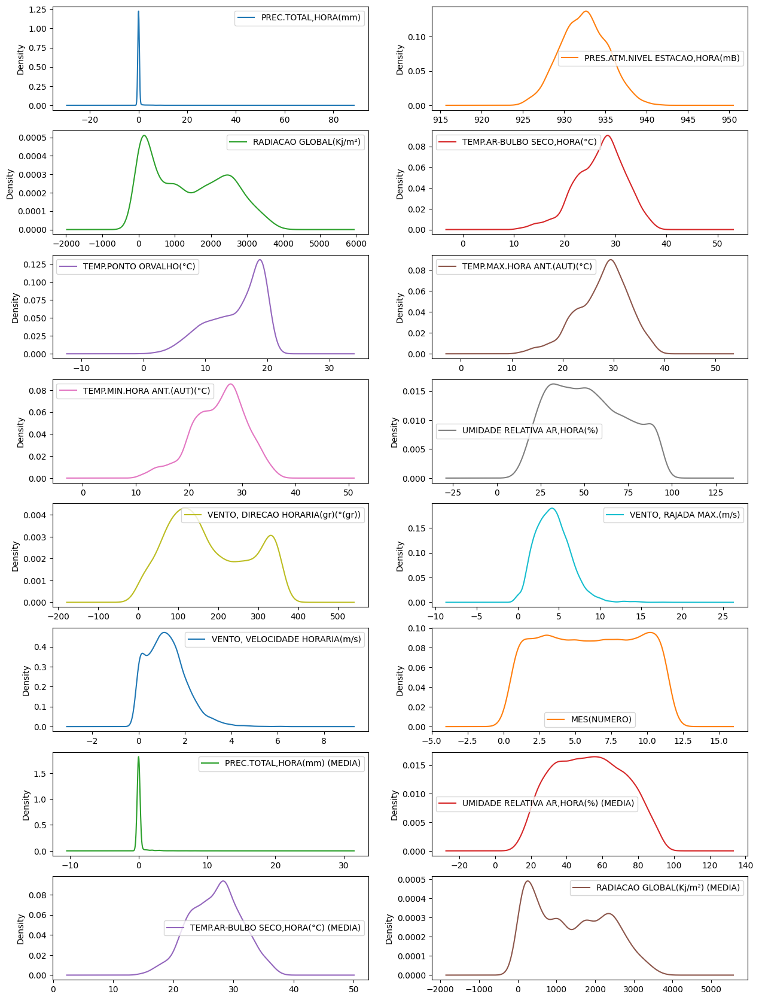

In [34]:
density = dataset
density = density.drop(['Data'], axis=1)
density.plot(kind = 'density', subplots = True, layout = (15,2), sharex = False, figsize = (15,40))
plt.show()

array([[<Axes: title={'center': 'Data'}>,
        <Axes: title={'center': 'PREC.TOTAL,HORA(mm)'}>,
        <Axes: title={'center': 'PRES.ATM.NIVEL ESTACAO,HORA(mB)'}>],
       [<Axes: title={'center': 'RADIACAO GLOBAL(Kj/m²)'}>,
        <Axes: title={'center': 'TEMP.AR-BULBO SECO,HORA(°C)'}>,
        <Axes: title={'center': 'TEMP.PONTO ORVALHO(°C)'}>],
       [<Axes: title={'center': 'TEMP.MAX.HORA ANT.(AUT)(°C)'}>,
        <Axes: title={'center': 'TEMP.MIN.HORA ANT.(AUT)(°C)'}>,
        <Axes: title={'center': 'UMIDADE RELATIVA AR,HORA(%)'}>],
       [<Axes: title={'center': 'VENTO, DIRECAO HORARIA(gr)(°(gr))'}>,
        <Axes: title={'center': 'VENTO, RAJADA MAX.(m/s)'}>,
        <Axes: title={'center': 'VENTO, VELOCIDADE HORARIA(m/s)'}>],
       [<Axes: title={'center': 'MES(NUMERO)'}>,
        <Axes: title={'center': 'PREC.TOTAL,HORA(mm) (MEDIA)'}>,
        <Axes: title={'center': 'UMIDADE RELATIVA AR,HORA(%) (MEDIA)'}>],
       [<Axes: title={'center': 'TEMP.AR-BULBO SECO,HORA(°C)

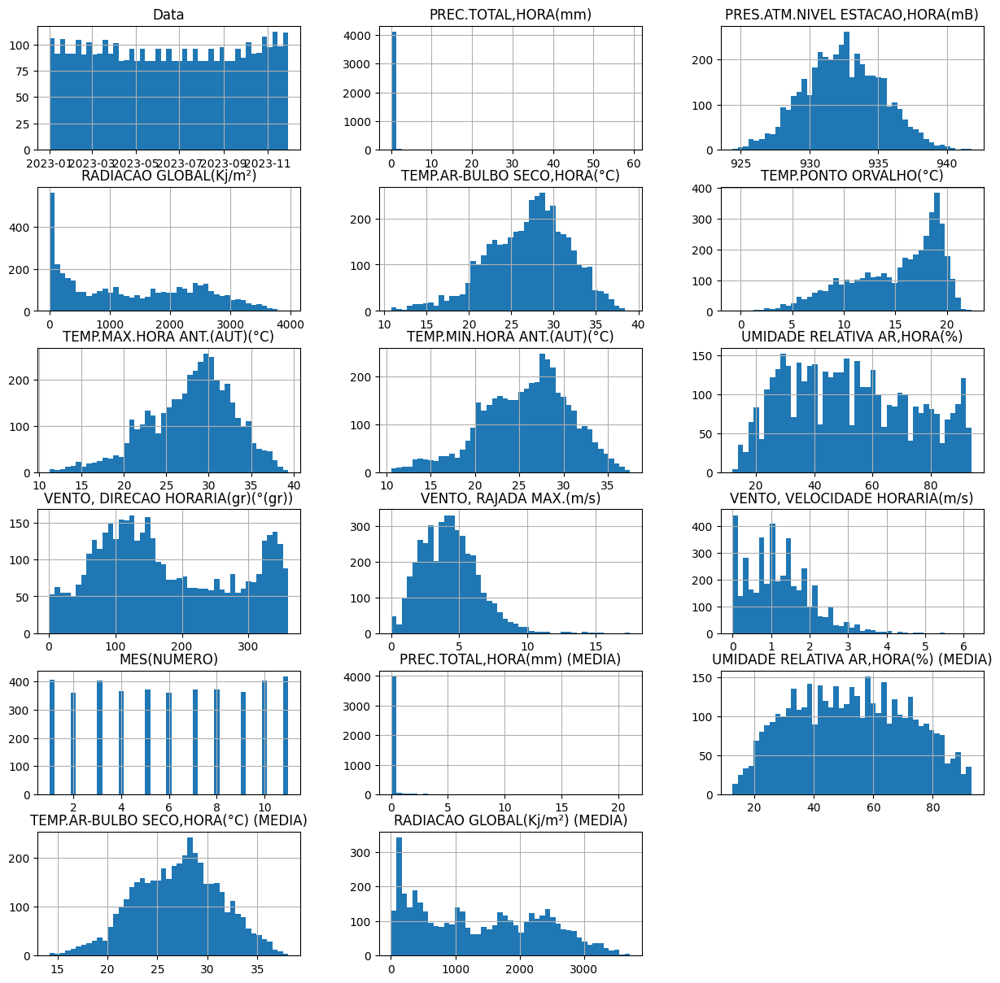

In [35]:
dataset.hist(bins=45, layout=(8,3), figsize = (15,20))

# Visualizações Multimodais

In [36]:
dataset.corr(method = 'pearson')

<ipython-input-36-e82437967361>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  dataset.corr(method = 'pearson')


,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO),"PREC.TOTAL,HORA(mm) (MEDIA)","UMIDADE RELATIVA AR,HORA(%) (MEDIA)","TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)",RADIACAO GLOBAL(Kj/m²) (MEDIA)
"PREC.TOTAL,HORA(mm)",1.000000,-0.053283,-0.088585,-0.112879,0.094428,-0.040591,-0.096759,0.159980,0.023327,0.202590,0.031926,-0.077912,0.626690,0.094534,-0.044414,-0.026300
"PRES.ATM.NIVEL ESTACAO,HORA(mB)",-0.053283,1.000000,0.035737,-0.397228,-0.322805,-0.449096,-0.473878,0.045987,-0.291235,-0.136089,0.056567,-0.052335,-0.083849,0.128820,-0.543619,-0.199079
RADIACAO GLOBAL(Kj/m²),-0.088585,0.035737,1.000000,0.657370,-0.153823,0.582002,0.558309,-0.563172,-0.020993,0.384220,0.451334,0.043738,-0.129993,-0.315449,0.396984,0.856423
"TEMP.AR-BULBO SECO,HORA(°C)",-0.112879,-0.397228,0.657370,1.000000,-0.239839,0.971480,0.966461,-0.818488,0.042573,0.401704,0.327847,0.302954,-0.152749,-0.655568,0.863460,0.773924
TEMP.PONTO ORVALHO(°C),0.094428,-0.322805,-0.153823,-0.239839,1.000000,-0.237036,-0.234919,0.715742,0.231465,-0.140034,-0.155430,-0.304085,0.152064,0.753845,-0.255502,-0.252076
TEMP.MAX.HORA ANT.(AUT)(°C),-0.040591,-0.449096,0.582002,0.971480,-0.237036,1.000000,0.966056,-0.800331,0.053206,0.463681,0.338197,0.287748,-0.120213,-0.684349,0.894118,0.760517
TEMP.MIN.HORA ANT.(AUT)(°C),-0.096759,-0.473878,0.558309,0.966461,-0.234919,0.966056,1.000000,-0.780719,0.057191,0.423199,0.312949,0.272247,-0.134211,-0.693870,0.922566,0.757673
"UMIDADE RELATIVA AR,HORA(%)",0.159980,0.045987,-0.563172,-0.818488,0.715742,-0.800331,-0.780719,1.000000,0.122583,-0.370054,-0.342492,-0.370881,0.232713,0.880316,-0.704657,-0.682411
"VENTO, DIRECAO HORARIA(gr)(°(gr))",0.023327,-0.291235,-0.020993,0.042573,0.231465,0.053206,0.057191,0.122583,1.000000,-0.037925,-0.140444,-0.010013,0.037078,0.120863,0.055319,0.005841
"VENTO, RAJADA MAX.(m/s)",0.202590,-0.136089,0.384220,0.401704,-0.140034,0.463681,0.423199,-0.370054,-0.037925,1.000000,0.762538,0.088917,0.105109,-0.328500,0.381828,0.511868


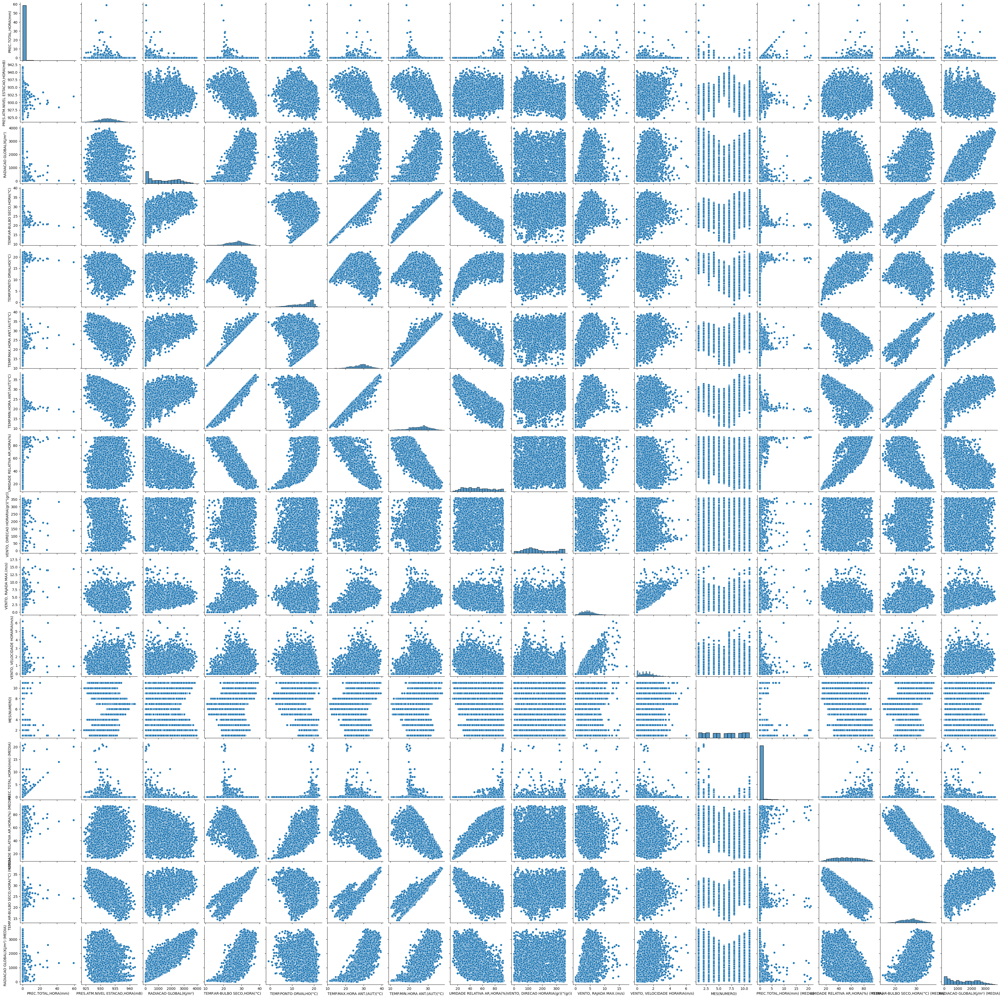

In [37]:
# Scatter Plot com Seaborn - Variação 1

sns.pairplot(dataset)

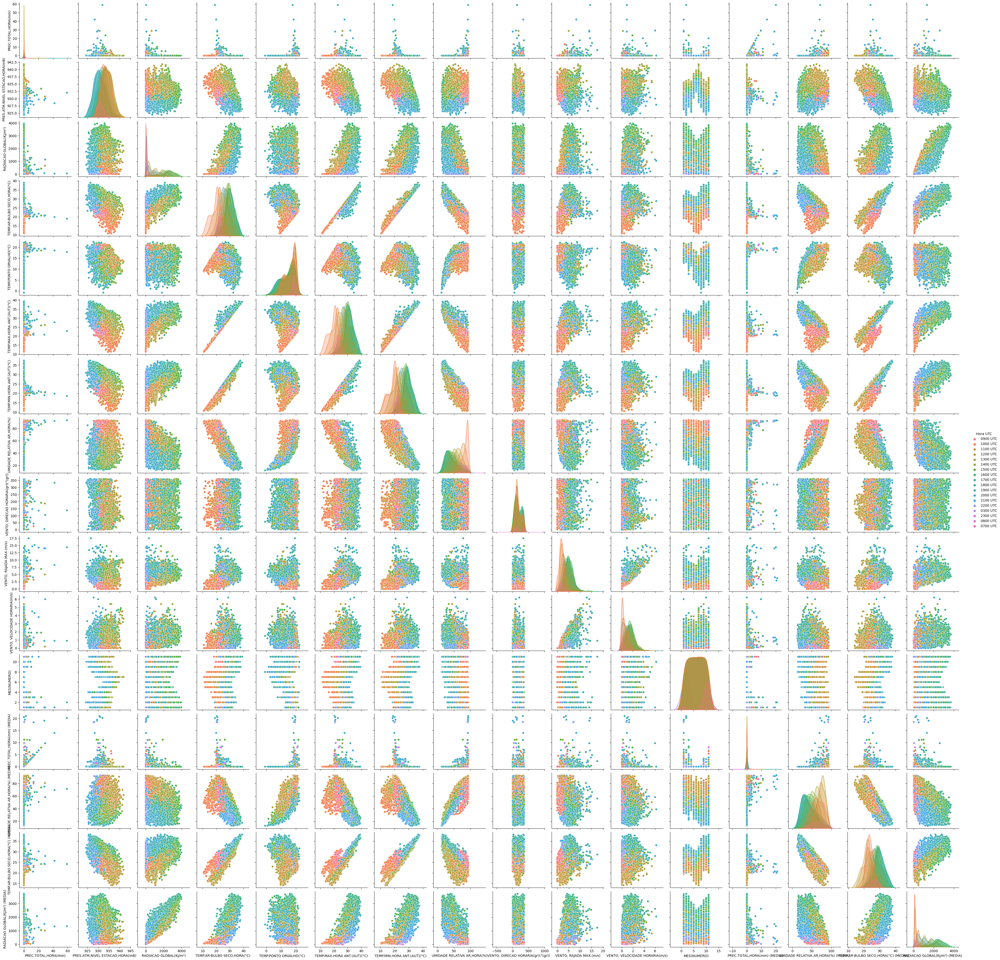

In [38]:
# Scatter Plot com Seaborn - Variação 2

sns.pairplot(dataset, hue = "Hora UTC", height = 2.5);

<ipython-input-39-3bf0ee6514fd>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(dataset.corr(), annot=True, cmap='RdBu', linewidths = .3, vmin=-1, vmax=1, ax=ax)


<Axes: >

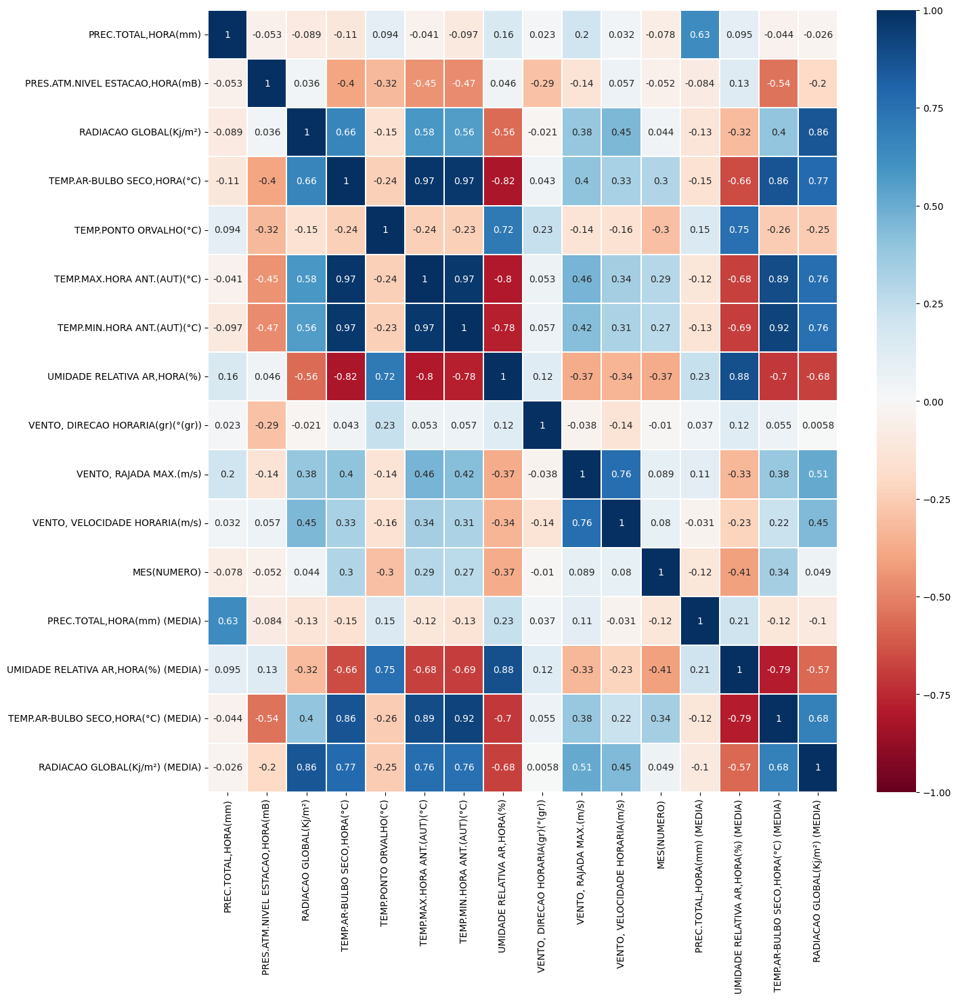

In [39]:
# Visualização do heatmap levando em consideração a correlação de Pearson

fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(dataset.corr(), annot=True, cmap='RdBu', linewidths = .3, vmin=-1, vmax=1, ax=ax)

<ipython-input-40-cd160065fd65>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(dataset.corr(method = 'spearman'), annot=True, cmap='RdBu', vmin=-1, vmax=1, ax = ax)


<Axes: >

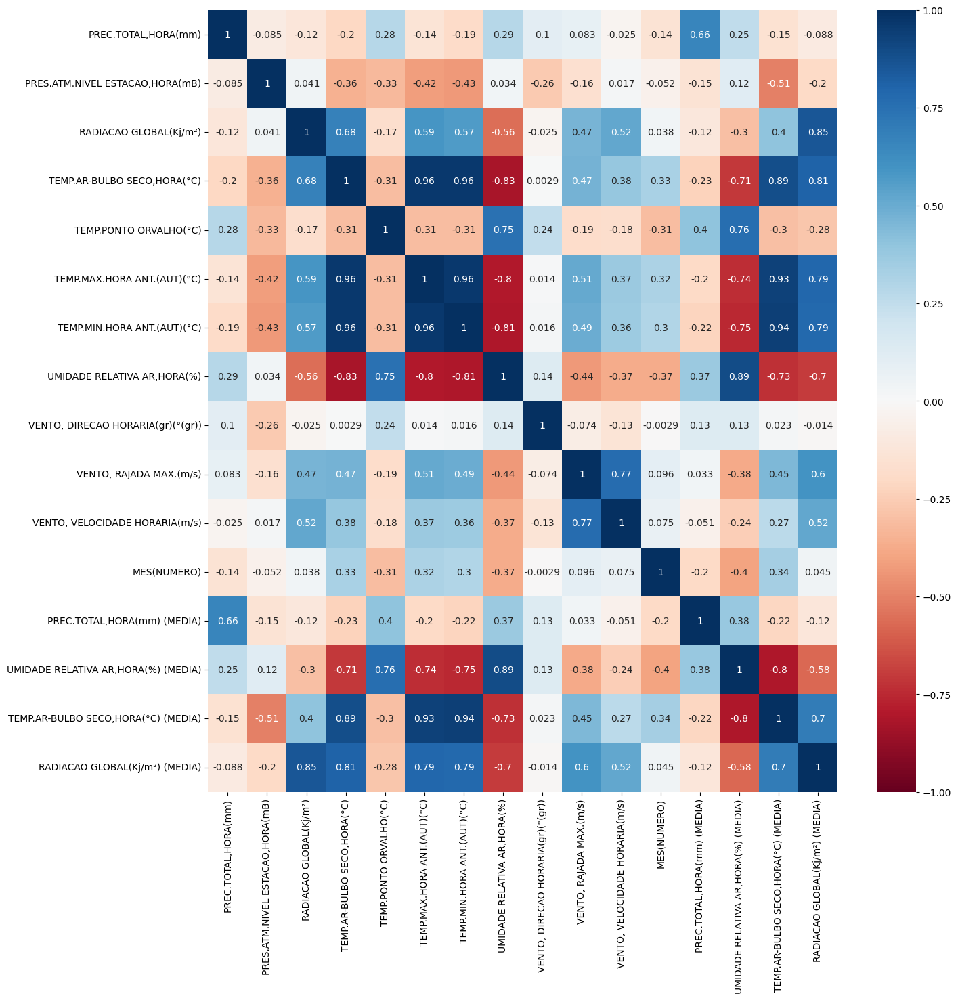

In [40]:
# Visualização do heatmap levando em consideração a correlação de Spearman

fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(dataset.corr(method = 'spearman'), annot=True, cmap='RdBu', vmin=-1, vmax=1, ax = ax)

<ipython-input-41-27ca0b19f120>:1: FutureWarning: The operation <function sum at 0x7e70ee91b1c0> failed on a column. If any error is raised, this will raise an exception in a future version of pandas. Drop these columns to avoid this warning.
  dataset_month = dataset.groupby(pd.Grouper(key='Data', axis=0, freq='M', sort=True)).aggregate(np.sum)


count     11.000000
mean      63.163636
std       81.386182
min        0.000000
25%        2.100000
50%       30.200000
75%       91.400000
max      270.600000
Name: PREC.TOTAL,HORA(mm), dtype: float64
            PREC.TOTAL,HORA(mm)  PRES.ATM.NIVEL ESTACAO,HORA(mB)  \
Data                                                               
2023-01-31                270.6                         378021.2   
2023-02-28                116.6                         336260.9   
2023-03-31                108.2                         374665.4   
2023-04-30                 67.8                         340085.4   
2023-05-31                  1.0                         347443.6   

            RADIACAO GLOBAL(Kj/m²)  TEMP.AR-BULBO SECO,HORA(°C)  \
Data                                                              
2023-01-31                541477.2                      10209.0   
2023-02-28                560957.2                       9792.6   
2023-03-31                496085.1                   

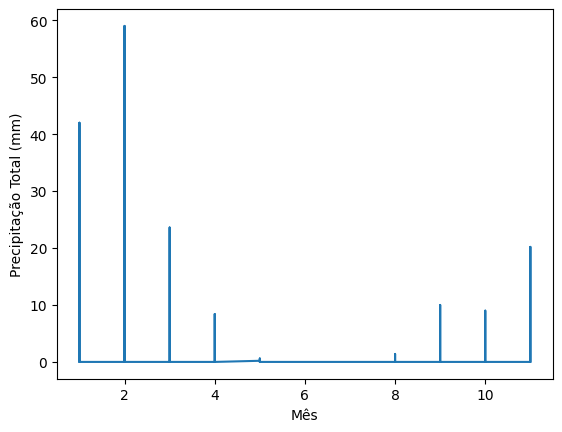

In [41]:
dataset_month = dataset.groupby(pd.Grouper(key='Data', axis=0, freq='M', sort=True)).aggregate(np.sum)
print(dataset_month['PREC.TOTAL,HORA(mm)'].describe())
print(dataset_month.head())

dataset_month = pd.concat([
    dataset['Data'],
    dataset.groupby('Data').transform(lambda x: x)
], axis=1)

#dataset_month["Data"] =  pd.to_datetime(dataset_month["Data"], format="%Y/%m/%d")

print(dataset_month['PREC.TOTAL,HORA(mm)'].describe())
print(dataset_month.head())

date_months_array  = dataset_month['Data'].dt.month
precipitacao_total_array = dataset_month['PREC.TOTAL,HORA(mm)']
plt.xlabel("Mês")
plt.ylabel("Precipitação Total (mm)")
plt.plot(date_months_array, precipitacao_total_array, linestyle = 'solid')
plt.show()

## 4.6. Resultado Após Pré-Processamento de dados

O pré-processamento está pronto. Retiramos da análise os dados faltantes e criamos algumas features interessantes para a análise.

Neste pré-processamente não foi realizado a normalização e padronização.

Vimos que as correlações de Pearson e Spearman possuem uma diferença, no caso o Spearman possui um pequena melhora nas correlações.

No passo X foram retiradas todas as instances que tivesse algum dado missing. Esta decisão pode ter retirado dados importantes para a construção do modelo. Mas foi bem executada com o objetivo de apresentar como é realizado a operação de limpeza dos dados.

In [42]:
# Mudando a coluna de precipitação total para a última coluna do dataset
dataset_aux = dataset.pop("PREC.TOTAL,HORA(mm)")
dataset.insert(len(dataset.columns), "PREC.TOTAL,HORA(mm)", dataset_aux)

# 5. Separação em conjunto de treino e conjunto de teste

Nesta etapa é executado o holdout. Esta operação é executada aqui separando 80% dos dados para treinamento e os 20% finais para validação do modelo.

In [43]:
test_size = 0.20
seed = 7

array = dataset.values
X = array[:,0:17]
y = array[:,17]

X_train, X_test, y_train, y_test = train_test_split(X, y,
    test_size=test_size, shuffle=True, random_state=seed) # sem estratificação

# 6. Conclusão

O objetivo do projeto foi executado mostrando todas as partes que um projeto de ciência de dados exige. Desde a coleta, tratamento, análise, pré-processamento dos dados. Claro que para finalizar até o deploy da solução ainda existem várias etapas, mas que serão exploradas nas próximas Sprints do curso.

Gostaria de deixar alguns pontos de atenção que pode ajudar em projetos futuros. Ao executar um projeto de ciência de dados, são necessários alguns processamentos de dados para prepará-los durante a construção de um modelo.
Dois tipos de processamentos são referentes a transformações numéricas, como a normalização e a padronização.

Ao executar este projeto, foi julgado que não seria necessário estas duas transformações.
Algumas das features estavam, visualmente, com formatos de distribuições normais. O que neste caso poderia ser aplicado a padronização. Porém, como os dados estavam aparentemente em uma escala bem conhecida e com dados outliers sendo indicados, porém dentro de intervalos reais, preferi não aplicar esta transformação.

Com relação as outras features que apresentavam comportamentos visuais exponenciais, poderia ser aplicado a normalização. Porém, também pelo mesmo motivo da padronização, julguei que os dados estavam em uma escala digamos "comportadas" para que não fosse necessário transformar.

Porém, como citado no livro **Engenharia de Software para Ciência de Dados(capítulo 9, página 262)** é importante entender os momentos certos para aplicar estas duas transformações para evitar o *Data Leakage* durante o treinamento do modelo.

# Anexos

### Anexo A - Boas Práticas de Software

1. Na seção 4.1 foi apresentado a funcionalidade que apresenta o gráfico com os dados missings. Foi possível verificar que este trecho de código foi utilizado repetidamente 3 vezes na mesma sessão.

Um boa prática, é criar uma função e reutilizar o código da chamada para realizar a construção do gráfico para anáise.
Veja um exemplo a seguir:

In [44]:
def visualizar_grafico_missings(data_frame):
    col = list(data_frame.columns)
    atributos = data_frame

    # exibindo visualização matricial da nulidade do dataset
    ms.matrix(atributos)


# Exemplo de como utilizar
# visualizar_grafico_missings(dataset)

### Anexo B - Dashboard

### Anexo C - Testes com PyTest

Uma boa prática na automatização na construção de modelos de machine learning é a realização de testes durante o pipeline.
Para que os sistemas inteligentes estejam sempre atualizados, além de aplicar boas práticas de códigos, devemos realizar algumas verificações nos dados e nos resultados dos processamentos para garantir que a esteira de implantação fique online a maior parte do tempo.

Realizar testes nos componentes do pipeline garante agilidade, custo menores na operação ao evitar processos errados e qualidade na acurácia do produto entregue.

Durante o pipeline realizamos o carregamento do datasource, processamos, limpamos os dados e treinamos os modelos. Então podemos ver que são bem claras as etapas dos testes.

Como utilizamos a tecnologia Python, é comum utilizar a biblioteca PyTest (https://docs.pytest.org/en/7.4.x/) para realizar os testes.

Por exemplo, segue alguns exemplos de testes para realizar no pipeline.

In [45]:
# Função para teste dos dados carregados
def testa_url_dataset(url):
    # A url informada do dataset não pode estar em branco
    assert len(url) != 0


# Função para testar se o dataset está ok
def testa_dataset_carregado(dt):
    assert dt.notnull
    assert len(dt.columns) == 20 # Dataset inicial esperado para este modelo tem que ter 20 colunas

# TESTES

In [46]:
test_size = 0.20
seed = 7

array = dataset.values
X = array[:,0:17]
y = array[:,17]

X_train, X_test, y_train, y_test = train_test_split(X, y,
    test_size=test_size, shuffle=True, random_state=seed) # sem estratificação

import numpy.ma as ma
print(dataset.columns)
print(dataset.shape)
print(ma.shape(X))
print(ma.shape(y))
print(ma.shape(array))
print(ma.shape(X_train))
print(ma.shape(X_test))
print(ma.shape(y_train))
print(ma.shape(y_test))

Index(['Data', 'Hora UTC', 'PRES.ATM.NIVEL ESTACAO,HORA(mB)',
       'RADIACAO GLOBAL(Kj/m²)', 'TEMP.AR-BULBO SECO,HORA(°C)',
       'TEMP.PONTO ORVALHO(°C)', 'TEMP.MAX.HORA ANT.(AUT)(°C)',
       'TEMP.MIN.HORA ANT.(AUT)(°C)', 'UMIDADE RELATIVA AR,HORA(%)',
       'VENTO, DIRECAO HORARIA(gr)(°(gr))', 'VENTO, RAJADA MAX.(m/s)',
       'VENTO, VELOCIDADE HORARIA(m/s)', 'MES(NUMERO)',
       'PREC.TOTAL,HORA(mm) (MEDIA)', 'UMIDADE RELATIVA AR,HORA(%) (MEDIA)',
       'TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)', 'RADIACAO GLOBAL(Kj/m²) (MEDIA)',
       'PREC.TOTAL,HORA(mm)'],
      dtype='object')
(4196, 18)
(4196, 17)
(4196,)
(4196, 18)
(3356, 17)
(840, 17)
(3356,)
(840,)


(array([19358., 19417., 19478., 19539., 19601., 19662.]),
 [Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03'),
  Text(19478.0, 0, '2023-05'),
  Text(19539.0, 0, '2023-07'),
  Text(19601.0, 0, '2023-09'),
  Text(19662.0, 0, '2023-11')])

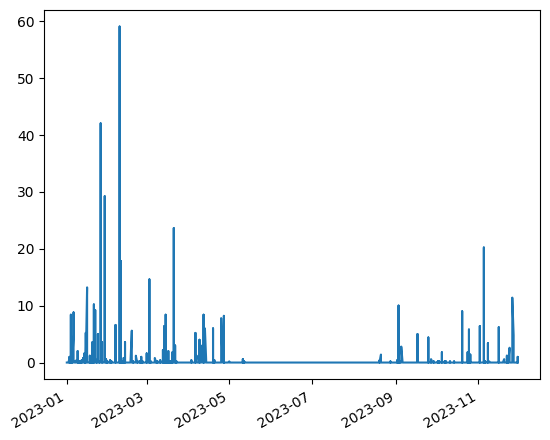

In [47]:
date_array  = dataset['Data']
price_array = dataset['PREC.TOTAL,HORA(mm)']
plt.plot(date_array, price_array, linestyle = 'solid')
plt.xticks(rotation=30, ha='right')

<ipython-input-48-2c2f051ec0bd>:1: FutureWarning: The operation <function sum at 0x7e70ee91b1c0> failed on a column. If any error is raised, this will raise an exception in a future version of pandas. Drop these columns to avoid this warning.
  xxx = dataset.groupby(pd.Grouper(key='Data', axis=0, freq='M', sort=True)).aggregate(np.sum)


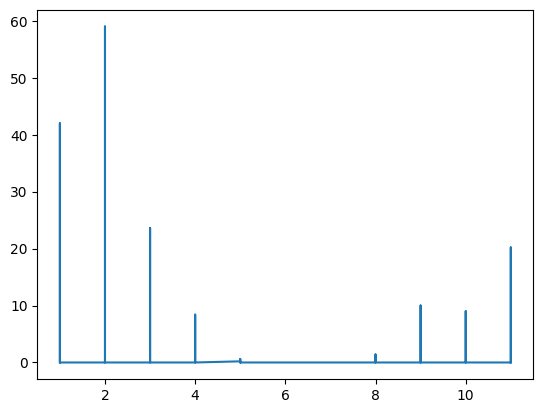

In [48]:
xxx = dataset.groupby(pd.Grouper(key='Data', axis=0, freq='M', sort=True)).aggregate(np.sum)
xxx['PREC.TOTAL,HORA(mm)']

xxx = pd.concat([
    dataset['Data'],
    dataset.groupby('Data').transform(lambda x: x)
], axis=1)
#xxx['Data']

date_array  = xxx['Data'].dt.month
price_array = xxx['PREC.TOTAL,HORA(mm)']
plt.plot(date_array, price_array, linestyle = 'solid')
#plt.xticks(rotation=30, ha='right')

In [49]:
dataset[dataset['PREC.TOTAL,HORA(mm)']>30]

,Data,Hora UTC,"PRES.ATM.NIVEL ESTACAO,HORA(mB)",RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO),"PREC.TOTAL,HORA(mm) (MEDIA)","UMIDADE RELATIVA AR,HORA(%) (MEDIA)","TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)",RADIACAO GLOBAL(Kj/m²) (MEDIA),"PREC.TOTAL,HORA(mm)"
620,2023-01-26,2000 UTC,928.4,38.3,19.9,18.5,27.7,19.8,92.0,333.0,8.3,0.9,1,14.000000,69.666667,25.700000,1326.166667,42.0
954,2023-02-09,1800 UTC,932.0,50.7,19.0,17.8,22.8,18.6,93.0,138.0,14.4,0.9,2,20.133333,71.333333,24.166667,1340.066667,59.0


In [50]:
start_date = '2023-01-31'
end_date   = '2023-02-05'
df2 = dataset.query('Data > @start_date and Data < @end_date')
df2.head()

,Data,Hora UTC,"PRES.ATM.NIVEL ESTACAO,HORA(mB)",RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO),"PREC.TOTAL,HORA(mm) (MEDIA)","UMIDADE RELATIVA AR,HORA(%) (MEDIA)","TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)",RADIACAO GLOBAL(Kj/m²) (MEDIA),"PREC.TOTAL,HORA(mm)"
754,2023-02-01,1000 UTC,932.1,118.8,20.6,19.2,20.7,19.3,91.0,247.0,2.2,0.1,2,0.0,76.000000,23.600000,196.200000,0.0
755,2023-02-01,1100 UTC,932.5,789.7,23.4,19.8,23.5,20.6,81.0,122.0,2.3,1.0,2,0.0,81.000000,22.766667,335.600000,0.0
756,2023-02-01,1200 UTC,933.0,1531.0,26.0,19.8,26.3,23.3,69.0,133.0,3.3,1.8,2,0.0,80.333333,23.333333,813.166667,0.0
757,2023-02-01,1300 UTC,933.2,2602.8,27.9,19.3,28.0,25.4,59.0,156.0,4.8,1.7,2,0.0,69.666667,25.766667,1641.166667,0.0
758,2023-02-01,1400 UTC,932.8,2779.0,28.0,19.6,28.7,27.4,61.0,171.0,4.7,1.8,2,0.0,63.000000,27.300000,2304.266667,0.0


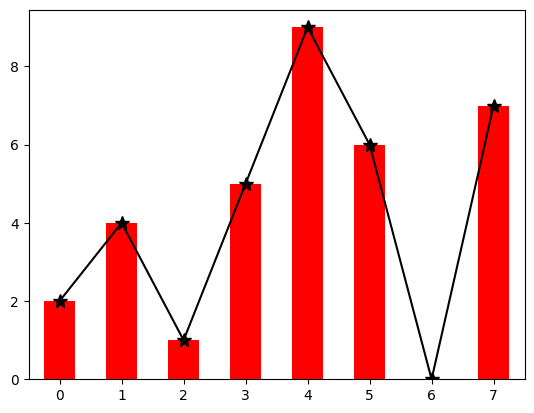

In [51]:
df = pd.DataFrame(dict(data=[2, 4, 1, 5, 9, 6, 0, 7]))
fig, ax = plt.subplots()

df['data'].plot(kind='bar', color='red')
df['data'].plot(kind='line', marker='*', color='black', ms=10)

plt.show()